In [1]:
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models, transforms, datasets

/home/danielpenchev/anaconda3/envs/pytorch-2.3/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/home/danielpenchev/anaconda3/envs/pytorch-2.3/lib/python3.10/site-packages/torchvision/image.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [2]:
image_resize_dims = (1280//2, 1067//2)

In [3]:
class VGG19FeatureExtractor(nn.Module):
    """
    VGG19 Feature Extractor for Neural Style Transfer
    Extracts features from multiple layers commonly used in style transfer
    """
    
    def __init__(self, pretrained=True):
        super(VGG19FeatureExtractor, self).__init__()
        
        # Load pretrained VGG19
        vgg = models.vgg19(pretrained=pretrained)
        self.features = vgg.features
        
        # Define layer mappings for style transfer
        # These are the commonly used layers in neural style transfer papers
        self.layer_names = {
            '0': 'conv1_1',    # Style layer 1
            '5': 'conv2_1',    # Style layer 2  
            '10': 'conv3_1',   # Style layer 3
            '19': 'conv4_1',   # Style layer 4
            '21': 'conv4_2',   # Content layer (commonly used)
            '28': 'conv5_1',   # Style layer 5
            '30': 'conv5_2',   # Last conv layer
        }
        
        # Default layers for content and style
        self.content_layers = ['conv4_2']
        self.style_layers = ['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1', 'conv5_1']
        
        # Freeze parameters (don't train the VGG network)
        for param in self.features.parameters():
            param.requires_grad = False
    
    def forward(self, x, layers=None):
        """
        Forward pass to extract features
        
        Args:
            x: Input tensor [batch_size, 3, H, W]
            layers: List of layer names to extract. If None, extracts all default layers
            
        Returns:
            Dictionary with layer names as keys and feature tensors as values
        """
        if layers is None:
            layers = list(self.layer_names.values())
        
        features = {}
        current_features = x
        
        for idx, layer in enumerate(self.features):
            current_features = layer(current_features)
            
            # Check if this layer should be saved
            if str(idx) in self.layer_names and self.layer_names[str(idx)] in layers:
                features[self.layer_names[str(idx)]] = current_features
        
        return features


    def get_content_features(self, x):
        return self.forward(x, self.content_layers)

    def get_style_features(self, x):
        return self.forward(x, self.style_layers)


def compute_gram_matrix(feature_vector):
    batch_size, channels,height, width = feature_vector.shape
    modified_feature_vector_view = feature_vector.view(batch_size, channels, height*width)
    gram_matrix = modified_feature_vector_view @ modified_feature_vector_view.transpose(1, 2)
    return gram_matrix / (batch_size * channels * height * width)

In [4]:
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

In [5]:
def def_image_transform(image_dims):
    return transforms.Compose([
               transforms.Resize(image_dims),
               transforms.ToTensor(),
               transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
            ])

In [6]:
def load_image(path, image_dims):
    image = Image.open(path)
    return def_image_transform(image_dims)(image)[:3, :, :].unsqueeze(0) # remove alpha channel and add batch dimension

In [7]:
def innormalize_image(tensor):
    return tensor * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])

In [8]:
style_image = load_image("./van_gogh.jpg", image_dims=image_resize_dims)
content_image = load_image("./tuebingen.jpg", image_dims=image_resize_dims)

In [9]:
style_image.shape

torch.Size([1, 3, 640, 533])

In [15]:
# Create target image as a leaf tensor that can be optimized
# We'll create it on the correct device from the start
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# target_image = torch.randn(content_image.shape, requires_grad=True, dtype=torch.float32, device=device)
# # Apply normalization to match the expected input range
# with torch.no_grad():
#     # Move normalization tensors to the same device
#     mean_tensor = torch.tensor([0.485, 0.456, 0.406], device=device)[:, None, None]
#     std_tensor = torch.tensor([0.229, 0.224, 0.225], device=device)[:, None, None]
#     target_image.data = (target_image.data - mean_tensor) / std_tensor

target_image = content_image.clone().requires_grad_(True).to(device)

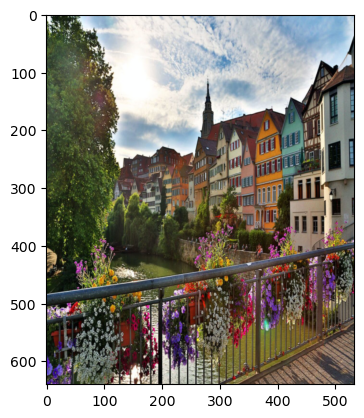

In [11]:
plt.imshow(im_convert(target_image))
plt.show()

In [12]:
def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    gram = None
    b, d, h, w = tensor.size()
    tensor = tensor.view(d, h*w)
    gram = torch.mm(tensor, tensor.t())
    return gram

In [13]:
def compute_gram_matrix(feature_vector):
    batch_size, channels,height, width = feature_vector.shape
    modified_feature_vector_view = feature_vector.view(batch_size, channels, height*width)
    gram_matrix = modified_feature_vector_view @ modified_feature_vector_view.transpose(1, 2)
    return gram_matrix #/ (batch_size * channels * height * width)

Total loss:  8131278336.0


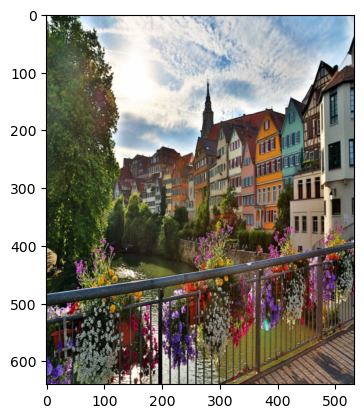

Total loss:  2198011648.0
Total loss:  861311808.0
Total loss:  338224608.0
Total loss:  197881728.0
Total loss:  144576400.0
Total loss:  113508536.0
Total loss:  92534688.0
Total loss:  77500560.0
Total loss:  66242176.0
Total loss:  57508420.0


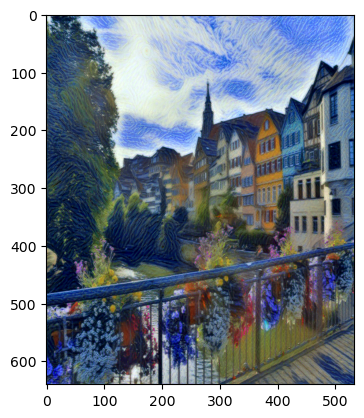

Total loss:  50510772.0
Total loss:  44760020.0
Total loss:  39938152.0
Total loss:  35827652.0
Total loss:  32272692.0
Total loss:  29167016.0
Total loss:  26432964.0
Total loss:  24006884.0
Total loss:  21843036.0
Total loss:  19904182.0


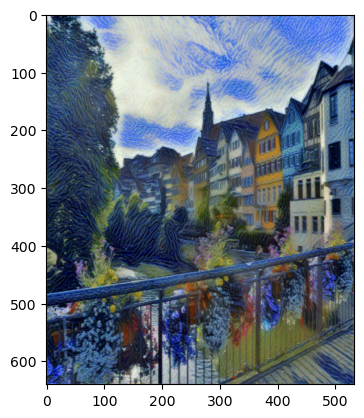

Total loss:  18162500.0
Total loss:  16594191.0
Total loss:  15175054.0
Total loss:  13888529.0
Total loss:  12719422.0
Total loss:  11655880.0
Total loss:  10687056.0
Total loss:  9803742.0
Total loss:  8997806.0
Total loss:  8262107.0


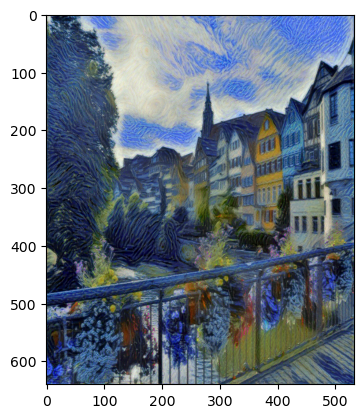

Total loss:  7589877.0
Total loss:  6976038.5
Total loss:  6416128.0
Total loss:  5905144.0
Total loss:  5438516.5
Total loss:  5012264.0
Total loss:  4623191.5
Total loss:  4268157.0
Total loss:  3944246.5
Total loss:  3648581.0


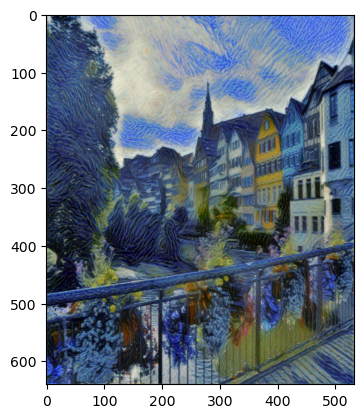

Total loss:  3378564.0
Total loss:  3131992.25
Total loss:  2906818.75
Total loss:  2701244.75
Total loss:  2513592.5
Total loss:  2342188.25
Total loss:  2185595.25
Total loss:  2042383.25
Total loss:  1911175.375
Total loss:  1790975.0


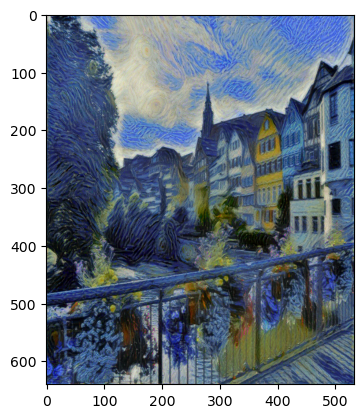

Total loss:  1680884.375
Total loss:  1579921.625
Total loss:  1487197.75
Total loss:  1401961.125
Total loss:  1323444.75
Total loss:  1250977.25
Total loss:  1184153.625
Total loss:  1122250.375
Total loss:  1064803.5
Total loss:  1011488.375


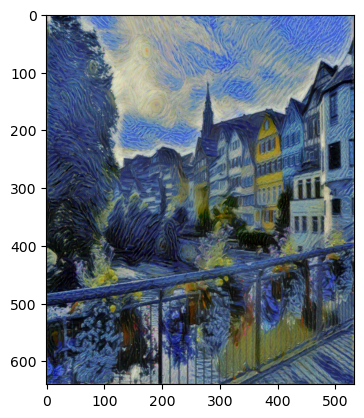

Total loss:  961867.25
Total loss:  915680.3125
Total loss:  874436.625
Total loss:  833793.9375
Total loss:  795853.6875
Total loss:  761880.8125
Total loss:  729824.9375
Total loss:  699124.125
Total loss:  674402.0
Total loss:  648948.75


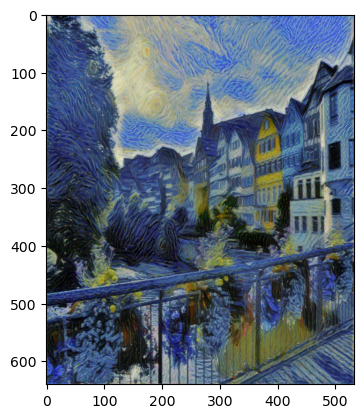

Total loss:  619620.1875
Total loss:  595440.0
Total loss:  574908.5
Total loss:  553628.4375
Total loss:  533680.6875
Total loss:  564198.4375
Total loss:  500037.125
Total loss:  489796.53125
Total loss:  475913.5625
Total loss:  464586.4375


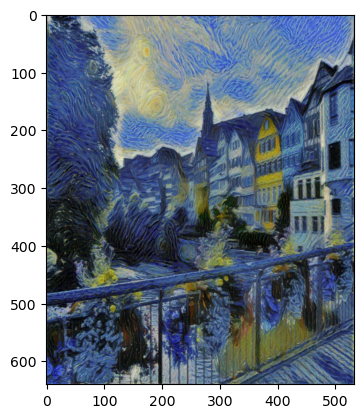

Total loss:  441987.78125
Total loss:  431368.5625
Total loss:  418187.78125
Total loss:  409020.84375
Total loss:  410626.21875
Total loss:  382344.96875
Total loss:  384868.9375
Total loss:  366734.9375
Total loss:  361030.0625
Total loss:  348309.28125


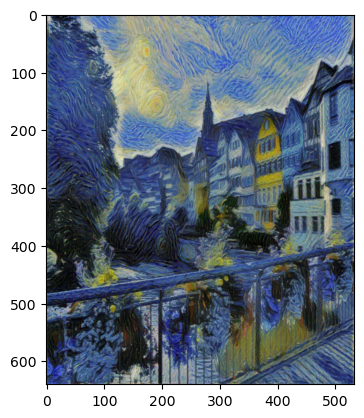

Total loss:  340267.25
Total loss:  333858.90625
Total loss:  327380.125
Total loss:  319047.9375
Total loss:  316809.5625
Total loss:  330028.8125
Total loss:  306472.8125
Total loss:  303524.0625
Total loss:  293258.96875
Total loss:  288559.3125


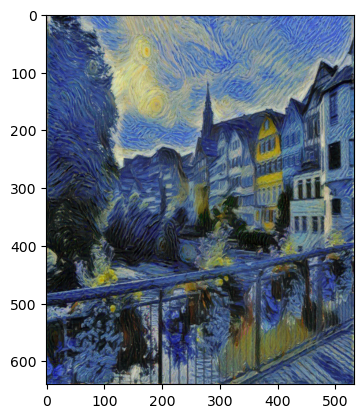

Total loss:  294467.4375
Total loss:  278195.28125
Total loss:  276795.09375
Total loss:  271489.90625
Total loss:  266899.34375
Total loss:  269074.78125
Total loss:  262105.0
Total loss:  255332.5
Total loss:  267375.40625
Total loss:  250071.984375


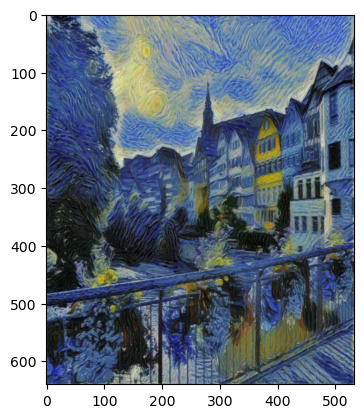

Total loss:  250325.28125
Total loss:  244778.796875
Total loss:  241338.90625
Total loss:  236011.828125
Total loss:  235833.375
Total loss:  272180.4375
Total loss:  232639.46875
Total loss:  227489.078125
Total loss:  229734.609375
Total loss:  238473.453125


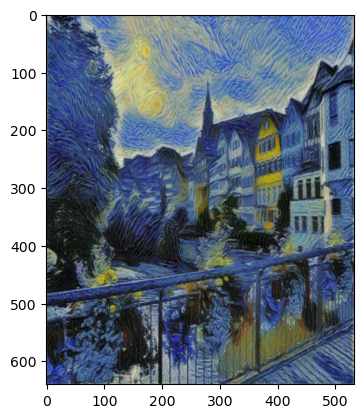

Total loss:  248465.046875
Total loss:  217279.546875
Total loss:  216473.96875
Total loss:  227454.9375
Total loss:  213941.78125
Total loss:  221066.078125
Total loss:  208238.5
Total loss:  207322.625
Total loss:  208790.40625
Total loss:  208337.1875


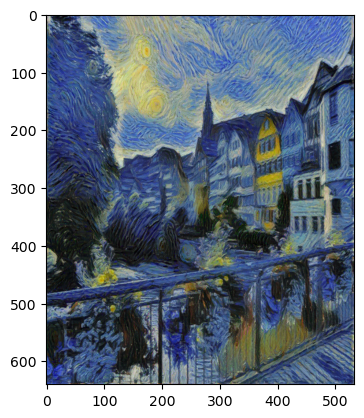

Total loss:  209948.171875
Total loss:  206664.953125
Total loss:  212711.765625
Total loss:  197017.90625
Total loss:  195623.296875
Total loss:  202471.234375
Total loss:  206642.21875
Total loss:  192050.671875
Total loss:  191929.21875
Total loss:  207935.53125


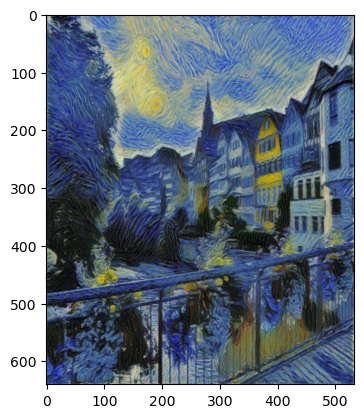

Total loss:  216324.1875
Total loss:  219825.875
Total loss:  201012.1875
Total loss:  185071.875
Total loss:  184628.0625
Total loss:  200351.6875
Total loss:  190975.609375
Total loss:  183434.421875
Total loss:  183765.140625
Total loss:  188566.28125


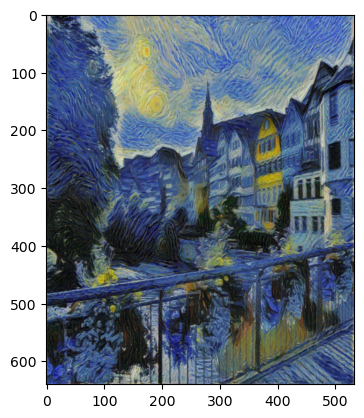

Total loss:  177542.34375
Total loss:  176572.71875
Total loss:  177850.15625
Total loss:  178507.6875
Total loss:  182374.390625
Total loss:  175945.234375
Total loss:  181492.6875
Total loss:  174081.265625
Total loss:  177261.921875
Total loss:  170662.546875


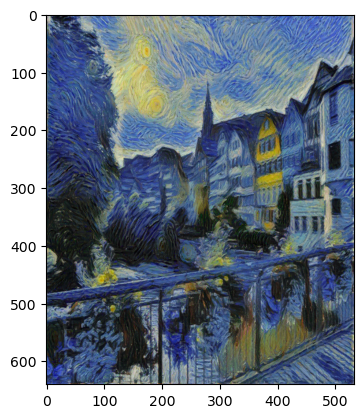

Total loss:  184690.171875
Total loss:  169147.109375
Total loss:  169548.59375
Total loss:  167354.640625
Total loss:  179350.234375
Total loss:  168979.28125
Total loss:  164654.546875
Total loss:  165388.6875
Total loss:  163121.859375
Total loss:  163307.4375


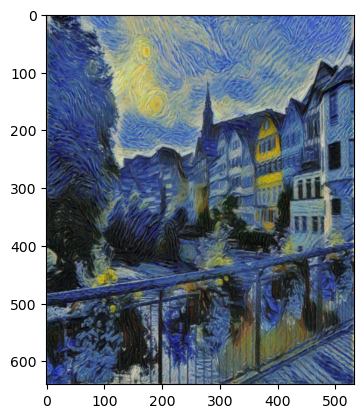

Total loss:  162359.28125
Total loss:  172553.921875
Total loss:  186525.140625
Total loss:  167134.96875
Total loss:  194218.5
Total loss:  170060.828125
Total loss:  160033.421875
Total loss:  160872.90625
Total loss:  186446.21875
Total loss:  170448.3125


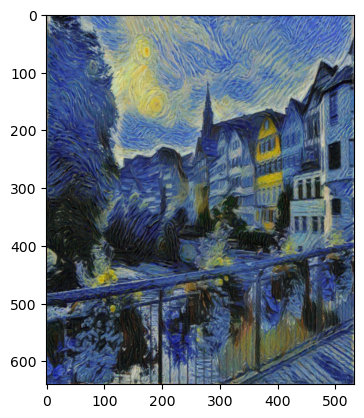

Total loss:  156737.71875
Total loss:  170297.84375
Total loss:  184371.125
Total loss:  155598.140625
Total loss:  159997.0
Total loss:  153573.546875
Total loss:  156125.28125
Total loss:  155196.4375
Total loss:  161303.265625
Total loss:  166614.65625


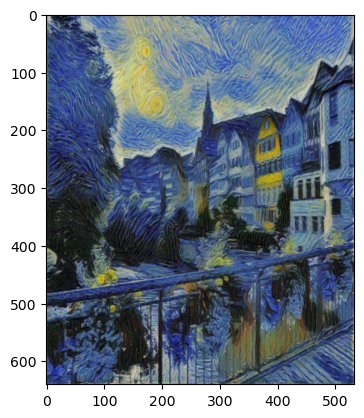

Total loss:  152044.640625
Total loss:  161298.921875
Total loss:  180482.46875
Total loss:  154358.96875
Total loss:  151578.0625
Total loss:  158885.515625
Total loss:  160355.171875
Total loss:  197605.71875
Total loss:  148409.15625
Total loss:  146984.375


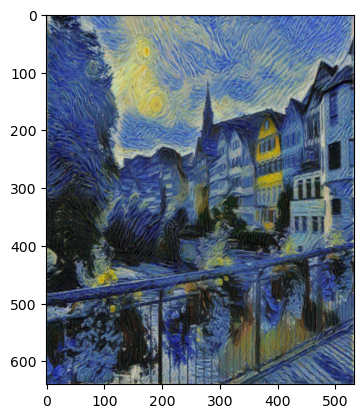

Total loss:  147273.96875
Total loss:  146148.109375
Total loss:  145868.1875
Total loss:  146019.59375
Total loss:  160911.1875
Total loss:  148564.421875
Total loss:  164309.390625
Total loss:  144530.8125
Total loss:  150811.3125
Total loss:  142872.5625


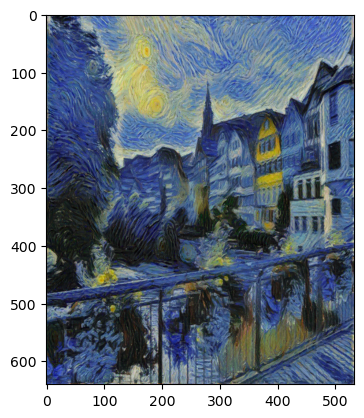

Total loss:  149023.375
Total loss:  147862.34375
Total loss:  151668.5
Total loss:  150256.109375
Total loss:  141190.171875
Total loss:  149309.4375
Total loss:  148569.609375
Total loss:  143120.890625
Total loss:  210590.84375
Total loss:  141232.453125


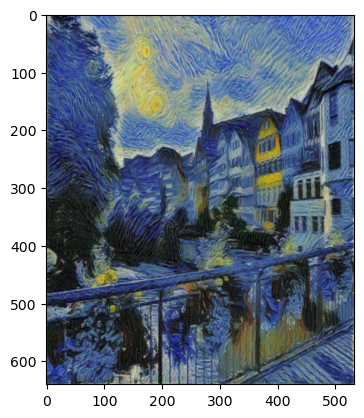

Total loss:  147303.546875
Total loss:  140742.734375
Total loss:  138908.09375
Total loss:  142636.640625
Total loss:  143626.640625
Total loss:  141196.59375
Total loss:  137506.109375
Total loss:  141675.5625
Total loss:  195472.8125
Total loss:  137074.796875


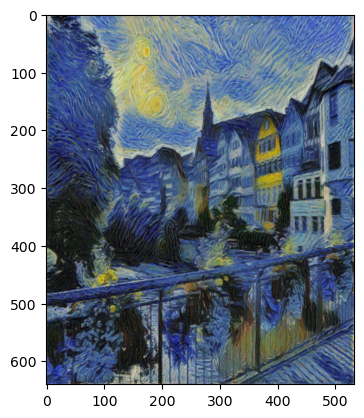

Total loss:  138610.390625
Total loss:  136911.015625
Total loss:  136903.671875
Total loss:  135900.265625
Total loss:  137227.09375
Total loss:  135621.234375
Total loss:  142782.53125
Total loss:  142610.421875
Total loss:  133890.015625
Total loss:  134689.265625


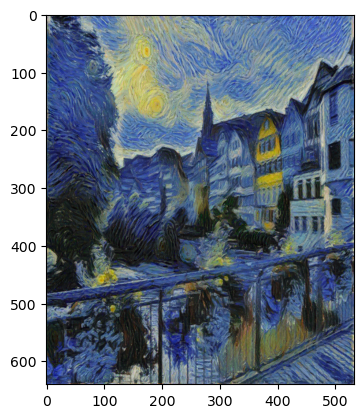

Total loss:  136672.625
Total loss:  139701.296875
Total loss:  151518.140625
Total loss:  134063.296875
Total loss:  135874.9375
Total loss:  133930.5625
Total loss:  134417.6875
Total loss:  147039.890625
Total loss:  243115.453125
Total loss:  134544.8125


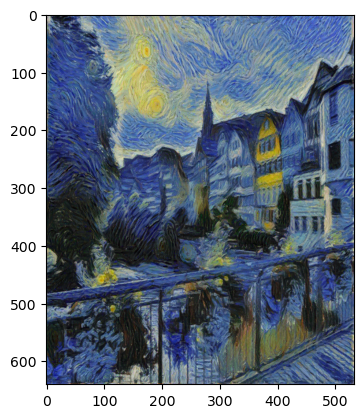

Total loss:  133429.9375
Total loss:  143286.8125
Total loss:  133324.84375
Total loss:  137690.0625
Total loss:  135105.296875
Total loss:  131721.09375
Total loss:  133005.453125
Total loss:  137500.6875
Total loss:  139658.15625
Total loss:  129990.3671875


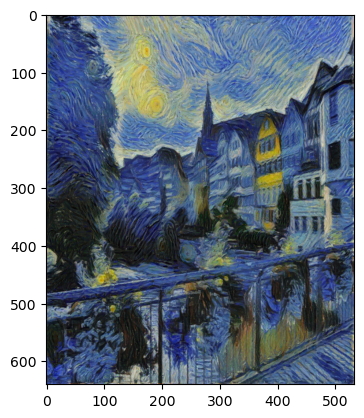

Total loss:  131823.703125
Total loss:  153434.03125
Total loss:  131679.78125
Total loss:  145715.125
Total loss:  128339.875
Total loss:  130798.0
Total loss:  127580.640625
Total loss:  137160.0
Total loss:  142325.328125
Total loss:  153093.0625


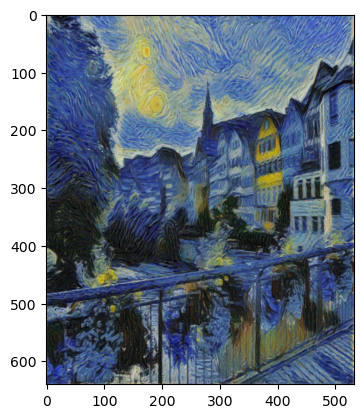

Total loss:  126676.2421875
Total loss:  127855.640625
Total loss:  132581.359375
Total loss:  131607.1875
Total loss:  128770.2578125
Total loss:  131383.046875
Total loss:  126667.921875
Total loss:  128544.15625
Total loss:  145591.828125
Total loss:  132117.28125


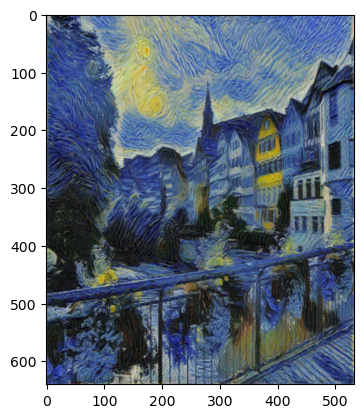

Total loss:  134517.34375
Total loss:  127004.890625
Total loss:  141359.578125
Total loss:  188089.140625
Total loss:  126801.0859375
Total loss:  123277.703125
Total loss:  130679.09375
Total loss:  124964.7109375
Total loss:  124250.78125
Total loss:  124329.4921875


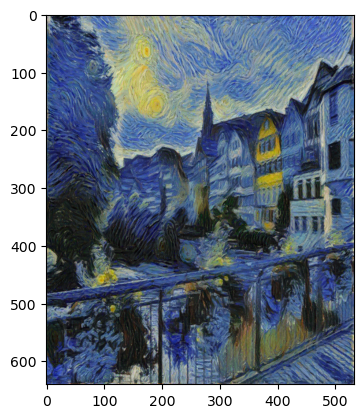

Total loss:  128055.3515625
Total loss:  125559.4921875
Total loss:  136986.4375
Total loss:  125918.953125
Total loss:  121754.125
Total loss:  136098.015625
Total loss:  139631.921875
Total loss:  122821.4921875
Total loss:  123964.8203125


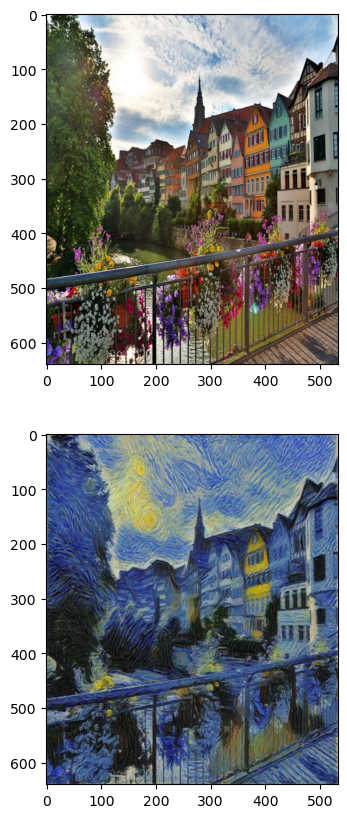

In [16]:
# Hyper-parameters
STEPS = 30000    # number of training epochs
LR = 0.003     # learning rate
show_loss = 100
show_image = 1000

content_weight = 1 # alpha
style_weights = {'conv1_1': 1.,
'conv2_1': 0.8,
'conv3_1': 0.5,
'conv4_1': 0.3,
'conv5_1': 0.1}
style_weight = 1e6

# Initialize encoder, projector and full model

content_image = content_image.to(device)
style_image = style_image.to(device)
# target_image is already on the correct device and is a leaf tensor

model = VGG19FeatureExtractor().to(device)
optimizer = torch.optim.Adam([target_image], lr=LR)


gram_matrix_style = {}
with torch.no_grad():
    style_image_features = model.get_style_features(style_image)
    for feature_layer_name in style_image_features:
        gram_matrix_style[feature_layer_name] = compute_gram_matrix(style_image_features[feature_layer_name])

# Training loop
for step in range(STEPS):

    batch_size, channels, height, width = target_image.shape
    content_image_features = model.get_content_features(content_image)
    target_image_features = model.forward(target_image)

    content_loss = 0
    for feature_layer_name in content_image_features:
        content_loss += torch.mean((target_image_features[feature_layer_name] - content_image_features[feature_layer_name].detach())**2)

    style_loss = 0
    for feature_layer_name in gram_matrix_style.keys():
        gram_matrix_target = compute_gram_matrix(target_image_features[feature_layer_name])
        layer_style_loss = torch.mean((gram_matrix_target - gram_matrix_style[feature_layer_name])**2)

        style_loss += layer_style_loss / (channels * height * width)
        #style_loss +=  torch.mean((gram_matrix_target - gram_matrix_style[feature_layer_name])**2)

    total_loss = content_weight * content_loss + style_weight * style_loss

        # iterate through each style layer and add to the style loss
    # for layer in style_weights:
    #     # get the "target" style representation for the layer
    #     target_feature = target_features[layer]
    #     _, d, h, w = target_feature.shape
    #     target_gram = gram_matrix(target_feature)
    #     style_gram = style_grams[layer]
    #     layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram) ** 2)
        
    #     # add to the style loss
    #     style_loss += layer_style_loss / (d * h * w)

        
    # update your target image
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    
    # display intermediate images and print the loss
    if  step % show_loss == 0:
        print('Total loss: ', total_loss.item())
        if step % show_image == 0:
            plt.imshow(im_convert(target_image))
            plt.show()
        
# display content and final, target image
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 10))
ax1.imshow(im_convert(content_image))
ax2.imshow(im_convert(target_image))


# TEST

In [ ]:
# import resources
%matplotlib inline

from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.optim as optim
from torchvision import
content_weight = 1 # alpha
style_weights = 100000# {'conv1_1': 1.,
#'conv2_1': 0.8,
#'conv3_1': 0.5,
#'conv4_1': 0.3,
#'conv5_1': 0.1}
ntent and style image
content = content_image #load_image('/kaggle/input/images1/baku.jpeg').to(device)
# Resize style to match content, makes code easier
style = style_image #load_image('/kaggle/input/images1/road.jpeg', shape=content.shape[-2:]).to(device)


###################


/home/danielpenchev/anaconda3/envs/pytorch-2.3/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/danielpenchev/anaconda3/envs/pytorch-2.3/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


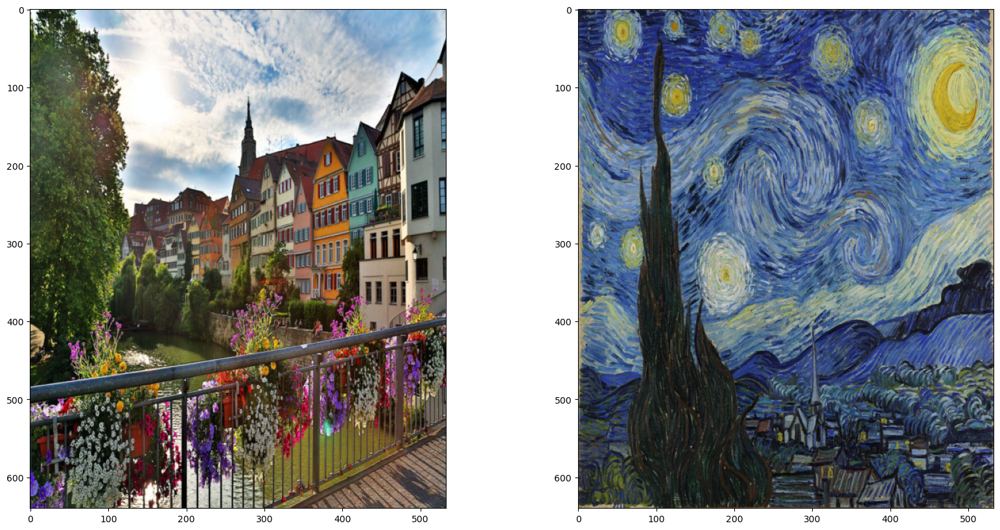

In [ ]:
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image
# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
# content and style ims side-by-side
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(style))

content_weight = 1 # alpha
style_weights = 100000# {'conv1_1': 1.,
#'conv2_1': 0.8,
#'conv3_1': 0.5,
#'conv4_1': 0.3,
#'conv5_1': 0.1}
ge
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            
    return features


def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    gram = None
    b, d, h, w = tensor.size()
    tensor = tensor.view(d, h*w)
    gram = torch.mm(tensor, tensor.t())
    return gram


In [80]:
# get content and style features only once before forming the target image
content_features = get_features(content, vgg)
style_features = get_features(style, vgg)

# calculate the gram matrices for each layer of our style representation
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

# create a third "target" image and prep it for change
# it is a good idea to start of with the target as a copy of our *content* image
# then iteratively change its style
target = content.clone().requires_grad_(True).to(device)


Total loss:  372205.59375


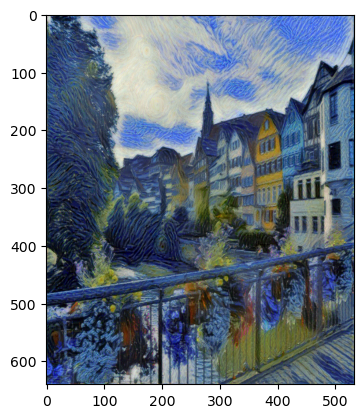

Total loss:  150034.71875


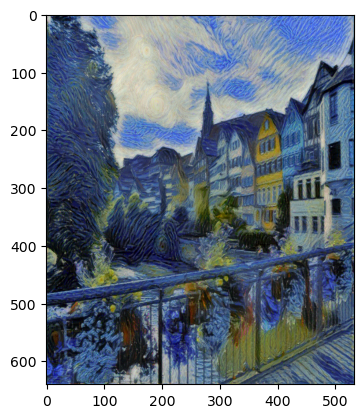

Total loss:  95339.375


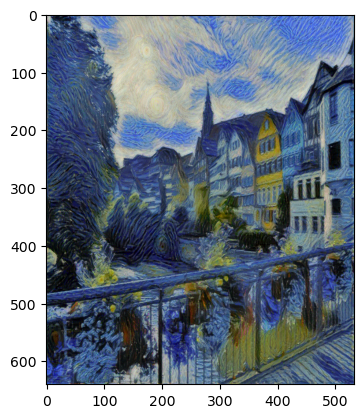

Total loss:  66653.0703125


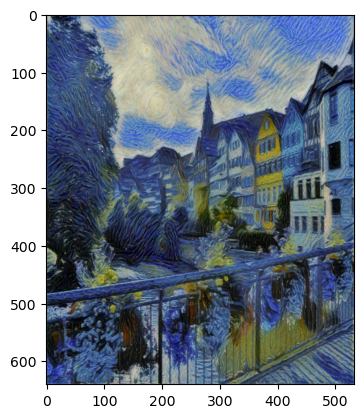

Total loss:  52373.78515625


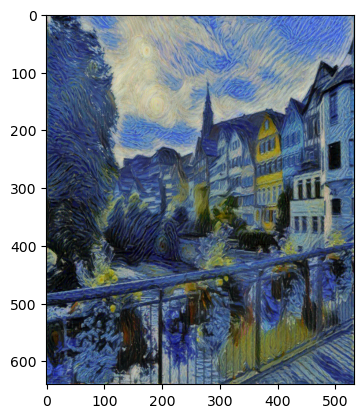

Total loss:  45686.0859375


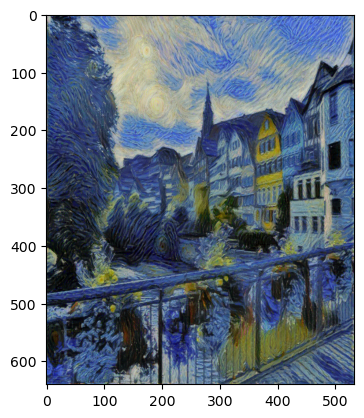

Total loss:  39077.4296875


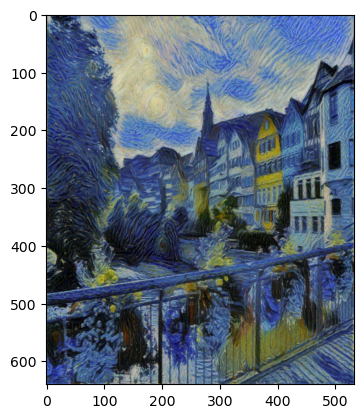

Total loss:  35476.6328125


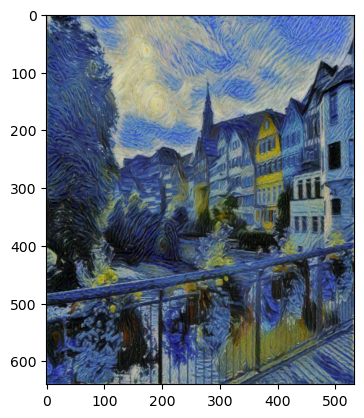

Total loss:  33240.58203125


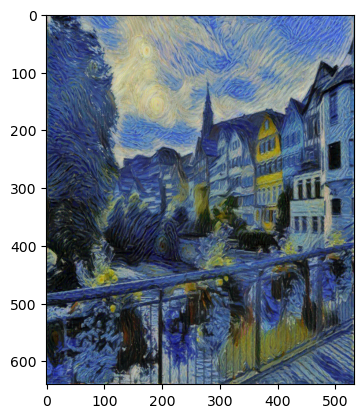

Total loss:  30822.85546875


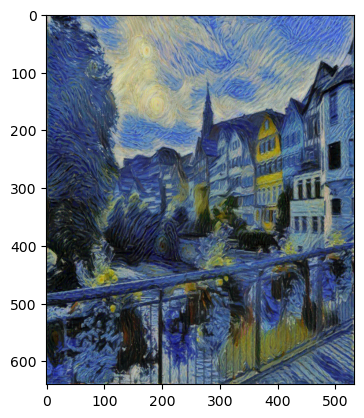

Total loss:  28378.353515625


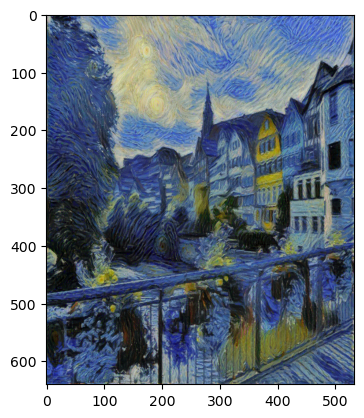

Total loss:  29622.50390625


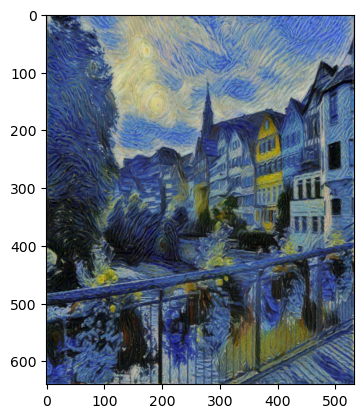

Total loss:  25523.68359375


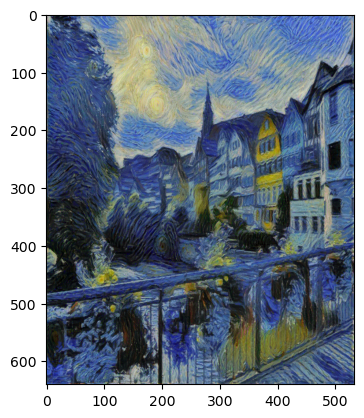

Total loss:  25361.033203125


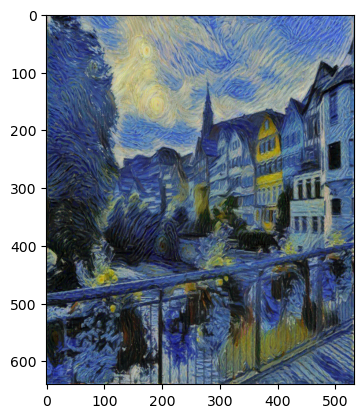

Total loss:  23932.8125


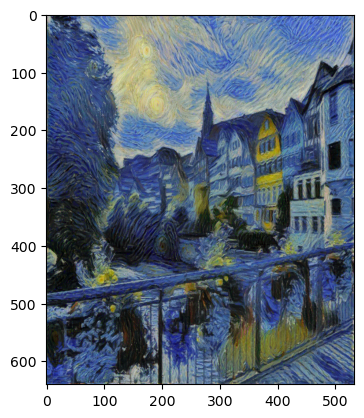

Total loss:  22882.0234375


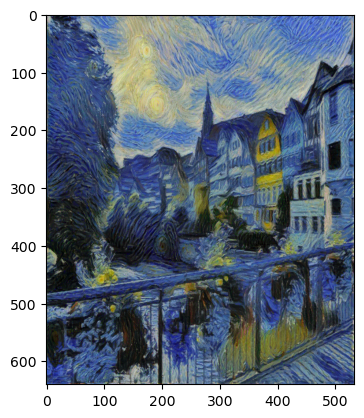

Total loss:  22610.326171875


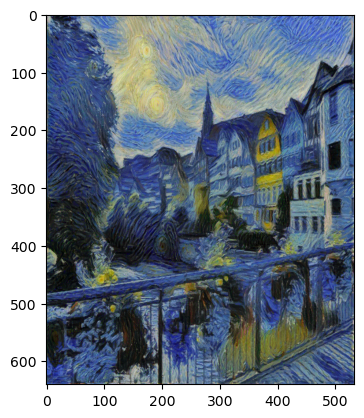

Total loss:  21864.4453125


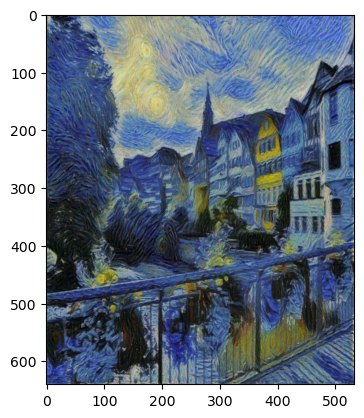

Total loss:  21121.0234375


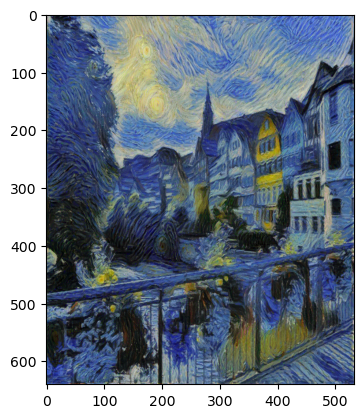

Total loss:  24164.7265625


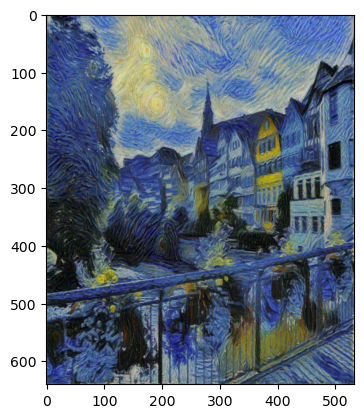

Total loss:  23701.74609375


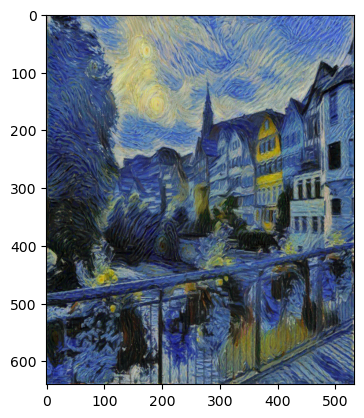

Total loss:  19429.30078125


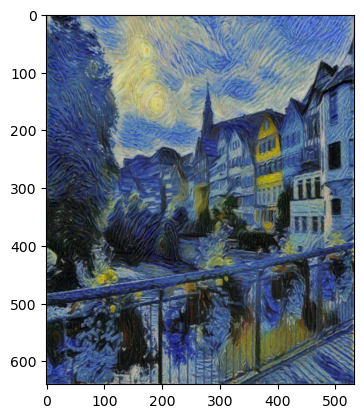

Total loss:  20225.765625


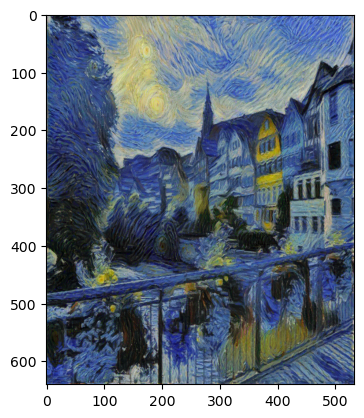

Total loss:  19397.982421875


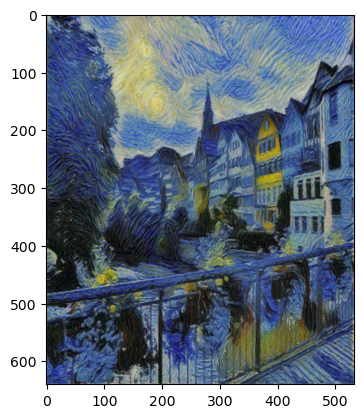

Total loss:  19281.3203125


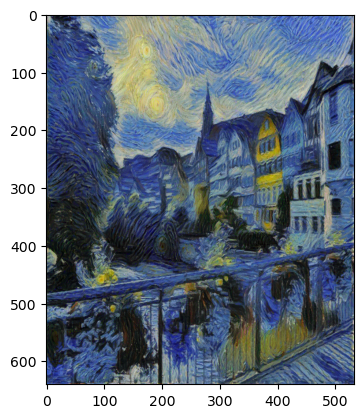

Total loss:  17992.572265625


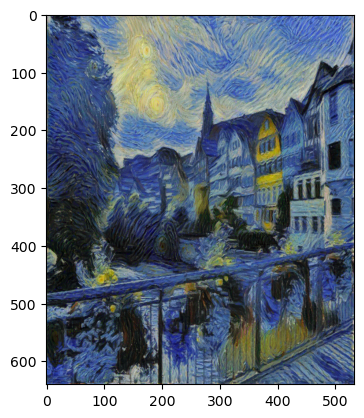

Total loss:  18555.66015625


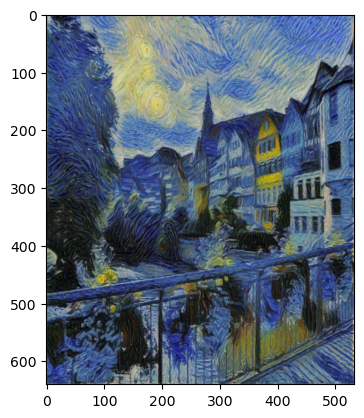

Total loss:  17869.12109375


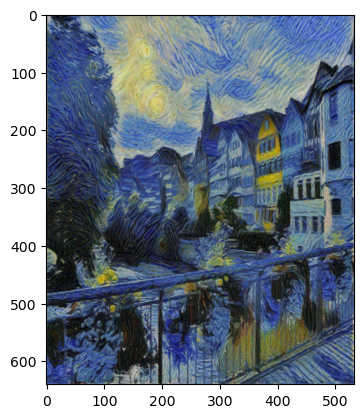

Total loss:  17641.396484375


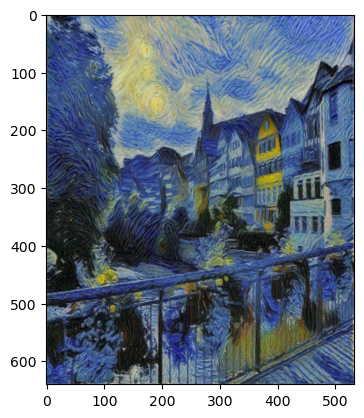

Total loss:  17037.359375


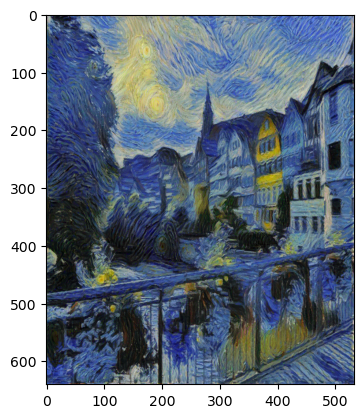

Total loss:  16697.330078125


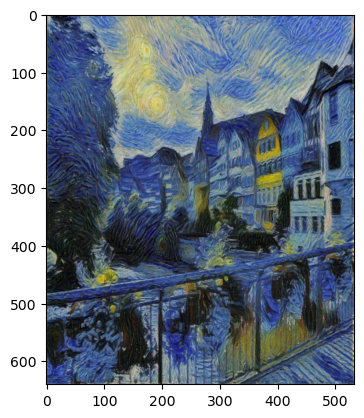

Total loss:  17733.025390625


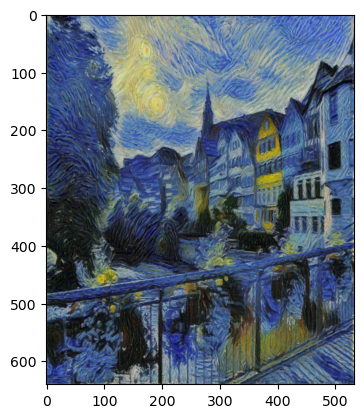

Total loss:  16377.080078125


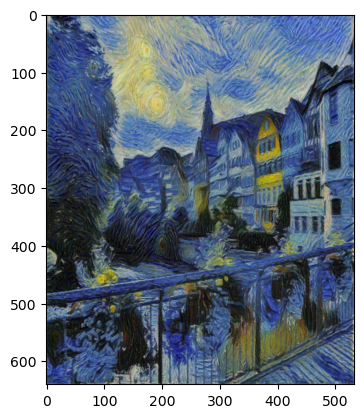

Total loss:  18050.103515625


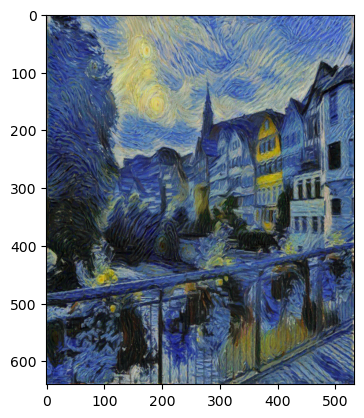

Total loss:  16352.4951171875


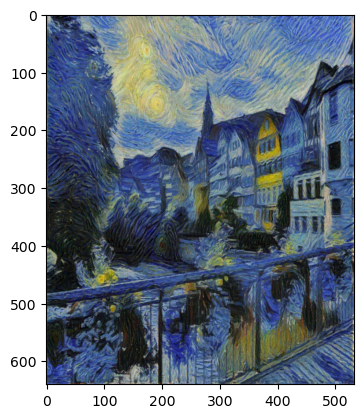

Total loss:  15922.1318359375


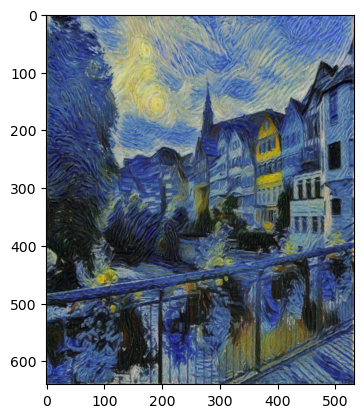

Total loss:  15638.451171875


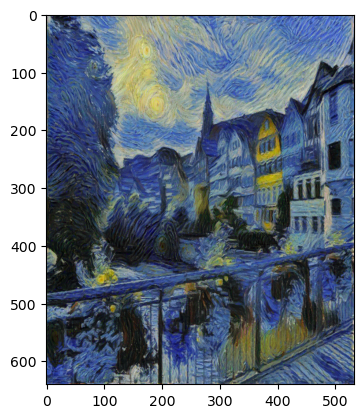

Total loss:  16100.384765625


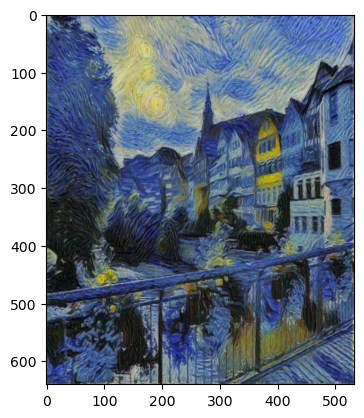

Total loss:  17250.9375


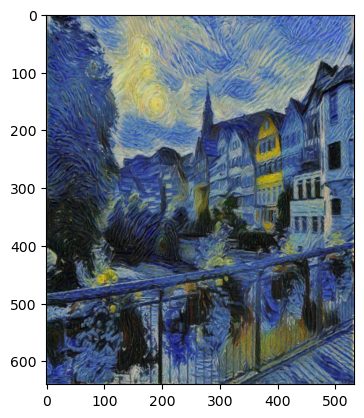

Total loss:  15292.9228515625


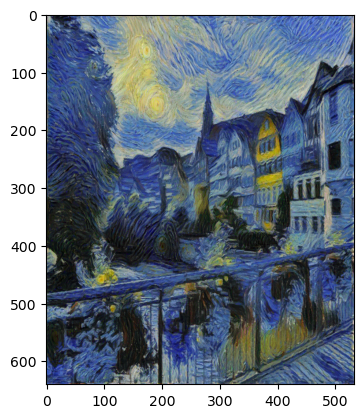

Total loss:  15140.2490234375


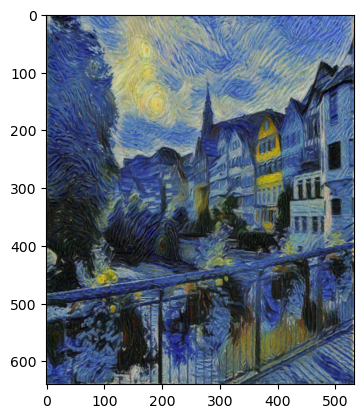

Total loss:  15446.8388671875


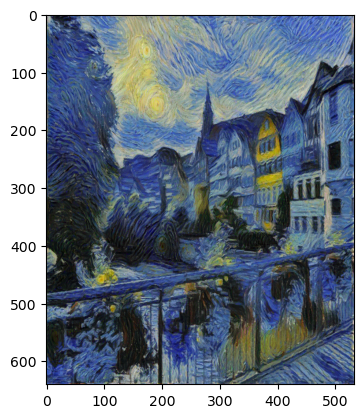

Total loss:  14918.392578125


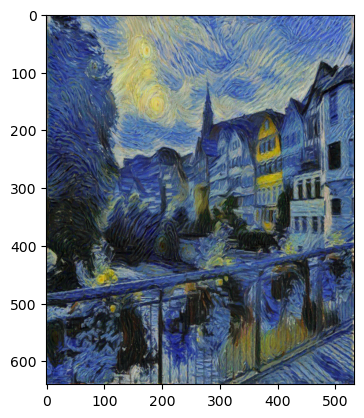

Total loss:  15069.55078125


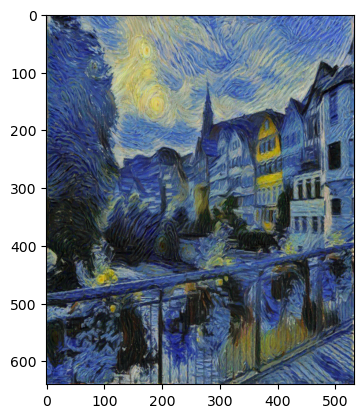

Total loss:  14649.79296875


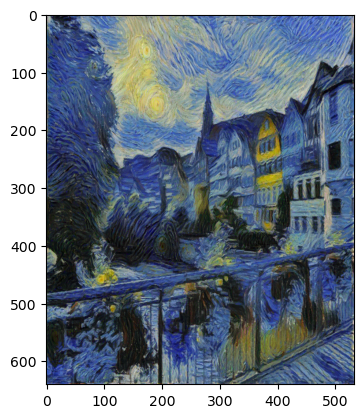

Total loss:  14562.564453125


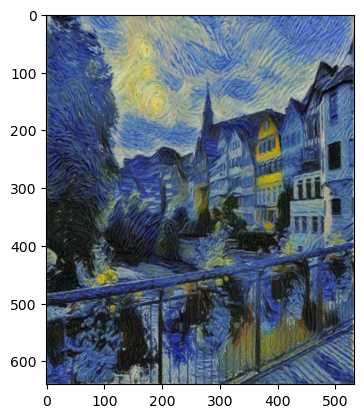

Total loss:  14366.6337890625


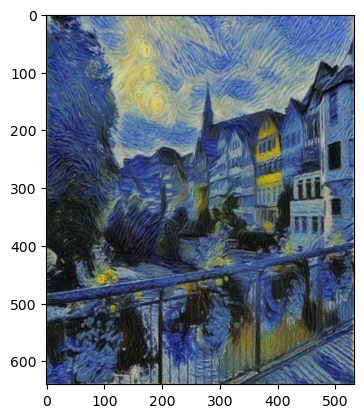

Total loss:  16453.333984375


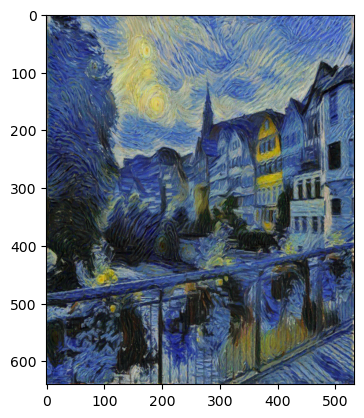

Total loss:  14326.140625


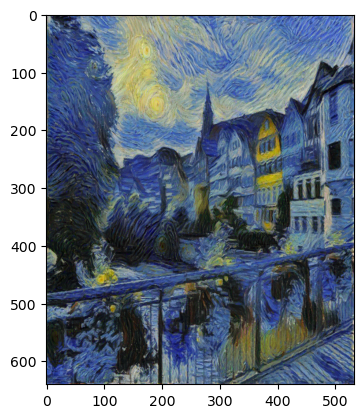

Total loss:  14484.349609375


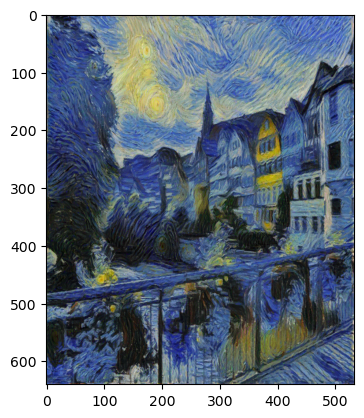

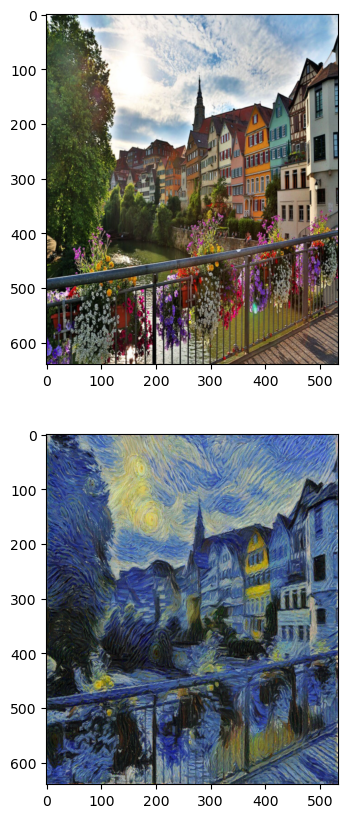

In [ ]:

# for displaying the target image, intermittently
show_every = 400


content_weight = 1 # alpha
style_weights = {'conv1_1': 1.,
'conv2_1': 0.8,
'conv3_1': 0.5,
'conv4_1': 0.3,
'conv5_1': 0.1}
style_weight = 1e6

# iteration hyperparameters
optimizer = optim.Adam([target], lr=0.003)
steps = 20000  # decide how many iterations to update your image (5000)

for ii in range(1, steps+1):
        
    ## Then calculate the content loss
    target_features = get_features(target, vgg)
    content_loss = torch.mean((target_features["conv4_2"] - content_features["conv4_2"]) ** 2)
    
    # the style loss
    # initialize the style loss to 0
    style_loss = 0
    # iterate through each style layer and add to the style loss
    for layer in style_weights:
        # get the "target" style representation for the layer
        target_feature = target_features[layer]
        _, d, h, w = target_feature.shape
        target_gram = gram_matrix(target_feature)
        style_gram = style_grams[layer]
        layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram) ** 2)
        
        # add to the style loss
        style_loss += layer_style_loss / (d * h * w)
        
    total_loss = content_weight * content_loss + style_weight * style_loss
    
    # update your target image
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()    for layer in style_weights:
        # get the "target" style representation for the layer
        target_feature = target_features[layer]
        _, d, h, w = target_feature.shape
        target_gram = gram_matrix(target_feature)
        style_gram = style_grams[layer]
        layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram) ** 2)
        
        # add to the style loss
        style_loss += layer_style_loss / (d * h * w)

        
    
    # display intermediate images and print the loss
    if  ii % show_every == 0:
        print('Total loss: ', total_loss.item())
        plt.imshow(im_convert(target))
        plt.show()
        
# display content and final, target image
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 10))
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(target))